%% [markdown]
# Visualização de Dados de Rastreamento de Futebol com mplsoccer

Este notebook demonstra como visualizar dados de rastreamento de futebol usando os pacotes `mplsoccer` e `kloppy`. 

## O que são Dados de Rastreamento?

Dados de rastreamento capturam as posições de todos os jogadores e da bola no campo, tipicamente a uma taxa de 10-25 vezes por segundo. 
Diferentemente dos dados de eventos que registram ações discretas (passes, chutes, etc.), dados de rastreamento fornecem informações contínuas sobre os movimentos dos jogadores,
permitindo-nos analisar:

- Posicionamento dos jogadores e formações
- Métricas físicas (distância percorrida, sprints, etc.)
- Padrões táticos e formas de equipe
- Criação e utilização de espaço

Neste notebook, vamos trabalhar com dados de rastreamento do PFF FC da Copa do Mundo FIFA 2022 masculina e aprender como:
1. Carregar e entender a estrutura de dados de rastreamento
2. Visualizar posições de jogadores em momentos específicos
3. Criar animações de movimentos de jogadores
4. Analisar padrões de movimento dos jogadores

In [1]:
# %%
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from kloppy import pff
import mplsoccer
from mplsoccer import Pitch, VerticalPitch
import matplotlib.animation as animation
from IPython.display import HTML
import os
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Definir semente aleatória para reprodutibilidade
np.random.seed(42)

%% [markdown]
## Carregando Dados de Rastreamento com Kloppy

O PFF FC divulgou seus dados de rastreamento de transmissão da Copa do Mundo FIFA 2022. Os conjuntos de dados podem ser solicitados através [deste link](https://www.blog.fc.pff.com/blog/pff-fc-release-2022-world-cup-data).

### O que é Kloppy?

`Kloppy` é uma biblioteca Python que nos ajuda a trabalhar com diferentes formatos de dados de futebol. Ela fornece uma maneira padronizada de carregar dados de rastreamento e eventos de vários provedores (como Metrica, Statsbomb, TRACAB e PFF FC). Isso nos poupa de ter que escrever código personalizado para cada formato de dados.

### Componentes Principais dos Dados:
- **Dados de Rastreamento**: Os dados de rastreamento são armazenados separadamente por jogo: `{game_id}.jsonl.bz2`
- **Dados de Eventos**: Os dados de eventos para todos os jogos são armazenados em um único arquivo: `events.json`
- **Metadados**: As informações de metadados (time da casa, time visitante, data do jogo, etc.). Os metadados de cada jogo são armazenados separadamente como `{game_id}.json`.
- **Elencos**: Os elencos contêm informações sobre as escalações dos times. Os elencos de cada jogo são armazenados separadamente como `{game_id}.json`.

### Carregando os Dados

Para carregar os dados de rastreamento como um TrackingDataset, usamos a função `load_tracking()` do módulo `pff` em kloppy.

**Parâmetros necessários:**
- `meta_data`: Caminho contendo metadados sobre os dados de rastreamento.
- `roster_meta_data`: Caminho contendo metadados do elenco, como detalhes dos jogadores.
- `raw_data`: Caminho contendo os dados brutos de rastreamento.

**Parâmetros opcionais:**
- `coordinates`: O sistema de coordenadas a ser usado para os dados de rastreamento (ex: "pff").
- `sample_rate`: A taxa de amostragem para reduzir os dados. Se None, nenhuma redução é aplicada.
- `limit`: O número máximo de registros a serem processados. Se None, todos os registros são processados.
- `only_alive`: Se deve incluir apenas sequências quando a bola está em jogo.

In [7]:
# %%
# Carregar os dados de rastreamento
# Ajuste os caminhos dos arquivos baseado na localização dos seus dados
dataset = pff.load_tracking(
    meta_data="data/pff_metadata_10517.json",
    roster_meta_data="data/pff_rosters_10517.json",
    raw_data="data/pff_10517.jsonl.bz2",
    # Parâmetros Opcionais
    coordinates="pff",
    sample_rate=None,
    limit=None
)

In [8]:
# Converter para DataFrame para manipulação mais fácil
df = dataset.to_df()

%% [markdown]
## Exploração Básica dos Dados

Antes de mergulhar nas visualizações, vamos explorar nossos dados de rastreamento para entender com o que estamos trabalhando.
Este é um primeiro passo essencial em qualquer projeto de ciência de dados!

In [ ]:
# %%
# Vamos primeiro olhar para as primeiras linhas dos dados
print("Primeiras 5 linhas dos nossos dados de rastreamento:")
print(df.head())

Primeiras 5 linhas dos nossos dados de rastreamento:
   period_id              timestamp  frame_id ball_state ball_owning_team_id  \
0          1 0 days 00:00:00.000821      4630      alive                 363   
1          1 0 days 00:00:00.034188      4631      alive                 363   
2          1 0 days 00:00:00.067555      4632      alive                 363   
3          1 0 days 00:00:00.100921      4633      alive                 363   
4          1 0 days 00:00:00.134288      4634      alive                 363   

   ball_x  ball_y  ball_z ball_speed  10715_x  ...  13226_d 13226_s 8058_x  \
0    0.42    1.59    0.39       None    4.987  ...     None    None    NaN   
1    0.83    1.63    0.00       None    4.955  ...     None    None    NaN   
2    1.23    1.66    0.00       None    4.923  ...     None    None    NaN   
3    1.64    1.70    0.02       None    4.892  ...     None    None    NaN   
4    2.04    1.73    0.02       None    4.861  ...     None    None    NaN  

In [ ]:
# %%
# Verificar a forma do nosso DataFrame - quantas linhas (frames) e colunas temos?
print(f"Forma do DataFrame: {df.shape} (linhas, colunas)")

Forma do DataFrame: (130308, 149) (linhas, colunas)


In [ ]:
# %%
# Quais colunas estão disponíveis em nosso conjunto de dados?
print("Nomes das colunas:")
for i, col in enumerate(df.columns):
    print(f"{i+1}. {col}")

Nomes das colunas:
1. period_id
2. timestamp
3. frame_id
4. ball_state
5. ball_owning_team_id
6. ball_x
7. ball_y
8. ball_z
9. ball_speed
10. 10715_x
11. 10715_y
12. 10715_d
13. 10715_s
14. 11_x
15. 11_y
16. 11_d
17. 11_s
18. 11856_x
19. 11856_y
20. 11856_d
21. 11856_s
22. 13222_x
23. 13222_y
24. 13222_d
25. 13222_s
26. 144_x
27. 144_y
28. 144_d
29. 144_s
30. 1531_x
31. 1531_y
32. 1531_d
33. 1531_s
34. 3868_x
35. 3868_y
36. 3868_d
37. 3868_s
38. 453_x
39. 453_y
40. 453_d
41. 453_s
42. 5116_x
43. 5116_y
44. 5116_d
45. 5116_s
46. 6895_x
47. 6895_y
48. 6895_d
49. 6895_s
50. 8025_x
51. 8025_y
52. 8025_d
53. 8025_s
54. 113_x
55. 113_y
56. 113_d
57. 113_s
58. 1532_x
59. 1532_y
60. 1532_d
61. 1532_s
62. 1534_x
63. 1534_y
64. 1534_d
65. 1534_s
66. 1675_x
67. 1675_y
68. 1675_d
69. 1675_s
70. 1789_x
71. 1789_y
72. 1789_d
73. 1789_s
74. 3870_x
75. 3870_y
76. 3870_d
77. 3870_s
78. 3888_x
79. 3888_y
80. 3888_d
81. 3888_s
82. 4606_x
83. 4606_y
84. 4606_d
85. 4606_s
86. 61_x
87. 61_y
88. 61_d
89. 61_

In [ ]:
# %%
# Vamos obter algumas estatísticas básicas sobre nossos dados
print("Estatísticas básicas para coordenadas da bola:")
print(df[['ball_x', 'ball_y', 'ball_z']].describe())

Estatísticas básicas para coordenadas da bola:
              ball_x         ball_y         ball_z
count  121027.000000  121027.000000  121027.000000
mean        0.400226       1.307667       0.892085
std        22.701843      17.726117       2.029492
min       -60.130000     -37.780000      -4.440000
25%       -15.720000     -12.930000       0.000000
50%         0.040000       2.090000       0.040000
75%        16.430000      15.720000       0.600000
max        57.550000      37.780000      15.870000


In [ ]:
# %%
# Quantos períodos existem na partida?
periods = df['period_id'].unique()
print(f"Períodos na partida: {periods}")

Períodos na partida: [1 2 3 4]


In [ ]:
# Verificar quantos frames temos por período
print("\nFrames por período:")
for period in periods:
    count = len(df[df['period_id'] == period])
    print(f"Período {period}: {count} frames")


Frames por período:
Período 1: 50426 frames
Período 2: 50488 frames
Período 3: 16519 frames
Período 4: 12875 frames


In [9]:
# remove columns wit suffix _d and _s
df = df.drop(columns=[col for col in df.columns if '_d' in col or '_s' in col and col != 'ball_state'])
# %%

In [10]:
# %%
# Vamos examinar quando a bola está em jogo vs. parada
ball_states = df['ball_state'].value_counts()
print("Distribuição de estados da bola:")
print(ball_states)

Distribuição de estados da bola:
ball_state
alive    130308
Name: count, dtype: int64


In [11]:
# Calcular a porcentagem de tempo que a bola está em jogo
in_play_pct = ball_states.get('alive', 0) / len(df) * 100
print(f"\nPorcentagem de tempo que a bola está em jogo: {in_play_pct:.2f}%")


Porcentagem de tempo que a bola está em jogo: 100.00%


%% [markdown]
### Entendendo a Estrutura dos Dados

Nossos dados de rastreamento contêm coordenadas para cada jogador e a bola em cada timestamp. Aqui está o que as principais colunas representam:

- `period_id`: O período da partida (1º tempo, 2º tempo, etc.)
- `timestamp`: Tempo em segundos desde o início do período
- `frame_id`: Identificador único para cada quadro de dados
- `ball_state`: Indica se a bola está 'alive' (em jogo) ou 'dead' (fora de jogo)
- `ball_owning_team_id`: ID do time em posse da bola
- `ball_x`, `ball_y`, `ball_z`: Coordenadas 3D da bola
- Coordenadas dos jogadores: Colunas como `{player_id}_x`, `{player_id}_y` com posições 2D de cada jogador

As coordenadas usam um sistema de coordenadas padrão de campo de futebol:
- eixo-x: ao longo do comprimento do campo (gol a gol)
- eixo-y: ao longo da largura do campo (linha lateral a linha lateral)
- Para dados PFF, as dimensões do campo são aproximadamente 72 x 36 em seu sistema de coordenadas

In [12]:
# %%
# Informações básicas sobre a partida a partir dos metadados
home_team = next(team.name for team in dataset.metadata.teams if str(team.ground) == "home")
away_team = next(team.name for team in dataset.metadata.teams if str(team.ground) == "away")
home_team_id = next(team.team_id for team in dataset.metadata.teams if str(team.ground) == "home")
away_team_id = next(team.team_id for team in dataset.metadata.teams if str(team.ground) == "away")

In [13]:
print(f"Partida: {home_team} (ID: {home_team_id}) vs {away_team} (ID: {away_team_id})")
print(f"Total de frames: {len(df)}")
print(f"Períodos: {df['period_id'].unique()}")
print(f"Intervalo de tempo: {df['timestamp'].min()} a {df['timestamp'].max()} segundos")

Partida: Argentina (ID: 364) vs France (ID: 363)
Total de frames: 130308
Períodos: [1 2 3 4]
Intervalo de tempo: 0 days 00:00:00.000291 a 0 days 00:53:36.549528 segundos


%% [markdown]
## Processamento de Dados e Identificação de Jogadores

Para visualizar as posições dos jogadores, precisamos identificar quais colunas correspondem a quais jogadores.
Isso requer algum processamento de dados:

1. Extrair IDs de jogadores a partir dos nomes das colunas
2. Combinar esses IDs com informações de jogadores dos metadados
3. Separar jogadores em seus respectivos times

Esta é uma tarefa comum de manipulação de dados em análises esportivas!

In [14]:
# %%
# PASSO 1: Extrair IDs de jogadores a partir dos nomes das colunas
# Procuramos por colunas terminando com '_x' que não são a bola
player_cols = [col for col in df.columns if '_x' in col and 'ball' not in col]
print(f"Encontradas {len(player_cols)} colunas de coordenadas de jogadores")
print(f"Colunas de exemplo: {player_cols[:3]}...")

Encontradas 35 colunas de coordenadas de jogadores
Colunas de exemplo: ['10715_x', '11_x', '11856_x']...


In [15]:
# Extrair apenas os IDs de jogadores desses nomes de colunas
player_ids = [int(col.split('_')[0]) for col in player_cols]
print(f"Extraídos {len(player_ids)} IDs de jogadores únicos")

Extraídos 35 IDs de jogadores únicos


In [16]:
# %%
# PASSO 2: Obter informações dos jogadores a partir dos metadados do conjunto de dados
player_info = {}
for team in dataset.metadata.teams:
    team_id = team.team_id
    team_name = team.name
    for player in team.players:
        player_id = int(player.player_id)
        if player_id in player_ids:
            player_info[player_id] = {
                'name': player.name,
                'jersey_no': player.jersey_no,
                'team_id': team_id,
                'team_name': team_name,
                'position': player.starting_position
            }

In [19]:
player_info

{13222: {'name': 'Nahuel Molina',
  'jersey_no': 26,
  'team_id': '364',
  'team_name': 'Argentina',
  'position': <PositionType.RightBack: ('Right Back', 'RB', 'FullBack')>},
 8058: {'name': 'Paulo Dybala',
  'jersey_no': 21,
  'team_id': '364',
  'team_name': 'Argentina',
  'position': <PositionType.Striker: ('Striker', 'ST', 'Attacker')>},
 8025: {'name': 'Nicolas Tagliafico',
  'jersey_no': 3,
  'team_id': '364',
  'team_name': 'Argentina',
  'position': <PositionType.LeftBack: ('Left Back', 'LB', 'FullBack')>},
 10715: {'name': 'Julian Alvarez',
  'jersey_no': 9,
  'team_id': '364',
  'team_name': 'Argentina',
  'position': <PositionType.Striker: ('Striker', 'ST', 'Attacker')>},
 5116: {'name': 'Cristian Romero',
  'jersey_no': 13,
  'team_id': '364',
  'team_name': 'Argentina',
  'position': <PositionType.RightCenterBack: ('Right Center Back', 'RCB', 'CenterBack')>},
 144: {'name': 'Emiliano Martínez',
  'jersey_no': 23,
  'team_id': '364',
  'team_name': 'Argentina',
  'position

In [17]:
# Vamos ver informações de um jogador como exemplo
print("Informações de exemplo de um jogador:")
example_player_id = list(player_info.keys())[0]
print(f"ID do Jogador: {example_player_id}")
for key, value in player_info[example_player_id].items():
    print(f"  {key}: {value}")

Informações de exemplo de um jogador:
ID do Jogador: 13222
  name: Nahuel Molina
  jersey_no: 26
  team_id: 364
  team_name: Argentina
  position: Right Back


In [18]:
# %%
# Converter o dicionário player_info em um DataFrame
players_df = pd.DataFrame.from_dict(player_info, orient='index').reset_index()
players_df.rename(columns={'index': 'player_id'}, inplace=True)

In [20]:
# Ordenar por team_name e jersey_no para melhor legibilidade
players_df = players_df.sort_values(['team_name', 'jersey_no'])

In [21]:
# Exibir o DataFrame
print(f"DataFrame criado com {len(players_df)} jogadores")
print(players_df.head())

DataFrame criado com 35 jogadores
    player_id                name  jersey_no team_id  team_name  \
2        8025  Nicolas Tagliafico          3     364  Argentina   
16       8419     Gonzalo Montiel          4     364  Argentina   
7        3856     Leandro Paredes          5     364  Argentina   
11      13226     German Pezzella          6     364  Argentina   
12       6895     Rodrigo de Paul          7     364  Argentina   

              position  
2            Left Back  
16          Right Back  
7   Defensive Midfield  
11   Right Center Back  
12     Center Midfield  


In [ ]:
# Estatísticas rápidas sobre jogadores por time
print("\nJogadores por time:")
print(players_df['team_name'].value_counts())


Jogadores por time:
team_name
France       18
Argentina    17
Name: count, dtype: int64


In [22]:
# Estatísticas rápidas sobre posições
print("\nJogadores por posição:")
print(players_df['position'].value_counts())


Jogadores por posição:
position
Center Midfield       7
Right Center Back     5
Striker               5
Left Back             3
Right Back            3
Right Wing            3
Left Wing             3
Left Center Back      2
Goalkeeper            2
Defensive Midfield    1
Name: count, dtype: int64


In [23]:
# %%
# PASSO 3: Criar listas separadas para jogadores da casa e visitantes
home_players = [player_id for player_id, info in player_info.items() if info['team_id'] == home_team_id]
away_players = [player_id for player_id, info in player_info.items() if info['team_id'] == away_team_id]

In [24]:
print(f"Time da casa ({home_team}) tem {len(home_players)} jogadores")
print(f"Time visitante ({away_team}) tem {len(away_players)} jogadores")

Time da casa (Argentina) tem 17 jogadores
Time visitante (France) tem 18 jogadores


In [25]:
# Exibir alguns jogadores de cada time (nome e número da camisa)
print("\nAlguns jogadores do time da casa:")
for p in home_players[:5]:
    print(f"  {player_info[p]['name']} (#{player_info[p]['jersey_no']}) - {player_info[p]['position']}")


Alguns jogadores do time da casa:
  Nahuel Molina (#26) - Right Back
  Paulo Dybala (#21) - Striker
  Nicolas Tagliafico (#3) - Left Back
  Julian Alvarez (#9) - Striker
  Cristian Romero (#13) - Right Center Back


In [ ]:
print("\nAlguns jogadores do time visitante:")
for p in away_players[:5]:
    print(f"  {player_info[p]['name']} (#{player_info[p]['jersey_no']}) - {player_info[p]['position']}")


Alguns jogadores do time visitante:
  Kingsley Coman (#20) - Right Wing
  Raphael Varane (#4) - Right Center Back
  Aurélien Tchouaméni (#8) - Center Midfield
  Ousmane Dembele (#11) - Right Wing
  Axel Disasi (#3) - Right Center Back


%% [markdown]
## Visualizando um Único Frame

Agora vamos visualizar como são as posições dos jogadores em um momento específico da partida.
Vamos usar o pacote `mplsoccer`, que fornece ferramentas de visualização específicas para futebol.

### O que é mplsoccer?

`mplsoccer` é uma biblioteca Python construída sobre matplotlib que fornece funções de plotagem específicas para futebol.
Ela torna muito mais fácil criar visualizações de futebol com:
- Campos de futebol pré-configurados com dimensões e marcações corretas
- Ferramentas para plotar posições de jogadores, passes, chutes, etc.
- Suporte para visualizações de dados de rastreamento e eventos

In [26]:
# %%
# Vamos criar uma função para visualizar um único frame de dados de rastreamento
def plot_frame(frame_data, title=None, ax=None, show_player_labels=True):
    """
    Plota um único frame de dados de rastreamento usando mplsoccer.
    
    Parâmetros:
    -----------
    frame_data : pandas.Series
        Uma única linha do dataframe de rastreamento contendo posições de jogadores e da bola
    title : str, opcional
        Título para o gráfico
    ax : matplotlib.axes.Axes, opcional
        Eixos para plotar. Se None, cria uma nova figura e eixos.
    show_player_labels : bool, padrão=True
        Se deve mostrar os números das camisas dos jogadores
        
    Retorna:
    --------
    fig : matplotlib.figure.Figure
        A figura contendo o gráfico
    ax : matplotlib.axes.Axes
        Os eixos contendo o gráfico
    """
    # Criar uma nova figura e eixos se não fornecidos
    if ax is None:
        # Criar um campo com fundo de grama e linhas brancas
        pitch = Pitch(pitch_type='skillcorner', pitch_length=105, pitch_width=68)
        fig, ax = pitch.draw(figsize=(12, 8))
    else:
        pitch = Pitch(pitch_type='skillcorner', pitch_length=105, pitch_width=68)
        fig = ax.figure
        pitch.draw(ax=ax)
    
    # Extrair posição da bola dos dados do frame
    ball_x = frame_data['ball_x']
    ball_y = frame_data['ball_y']
    
    # Dimensionar o tamanho da bola baseado na altura (se disponível)
    # Valor maior significa que a bola está mais alta do chão
    ball_size = 12
    
    # Plotar a bola como um círculo branco com contorno preto
    pitch.scatter(ball_x, ball_y, s=ball_size, color='white', edgecolors='black', zorder=20, ax=ax)
    
    # Plotar jogadores do time da casa (círculos azuis)
    for player_id in home_players:
        x_col = f"{player_id}_x"
        y_col = f"{player_id}_y"
        
        # Plotar apenas se as coordenadas do jogador existirem e não forem NaN
        if x_col in frame_data and y_col in frame_data and not pd.isna(frame_data[x_col]) and not pd.isna(frame_data[y_col]):
            player_x = frame_data[x_col]
            player_y = frame_data[y_col]
            jersey_num = player_info[player_id]['jersey_no']
            
            # Desenhar o jogador como um círculo azul
            pitch.scatter(player_x, player_y, s=120, color='blue', edgecolors='white', zorder=10, ax=ax)
            
            # Adicionar o número da camisa do jogador dentro do círculo
            if show_player_labels:
                ax.text(player_x, player_y, str(jersey_num), color='white', fontsize=8, 
                        ha='center', va='center', zorder=15)
    
    # Plotar jogadores do time visitante (círculos vermelhos)
    for player_id in away_players:
        x_col = f"{player_id}_x"
        y_col = f"{player_id}_y"
        
        # Plotar apenas se as coordenadas do jogador existirem e não forem NaN
        if x_col in frame_data and y_col in frame_data and not pd.isna(frame_data[x_col]) and not pd.isna(frame_data[y_col]):
            player_x = frame_data[x_col]
            player_y = frame_data[y_col]
            jersey_num = player_info[player_id]['jersey_no']
            
            # Desenhar o jogador como um círculo vermelho
            pitch.scatter(player_x, player_y, s=120, color='red', edgecolors='white', zorder=10, ax=ax)
            
            # Adicionar o número da camisa do jogador dentro do círculo
            if show_player_labels:
                ax.text(player_x, player_y, str(jersey_num), color='white', fontsize=8, 
                        ha='center', va='center', zorder=15)
    
    # Adicionar título se fornecido
    if title:
        ax.set_title(title, fontsize=16)
    
    # Adicionar nomes dos times nos cantos do campo
    ax.text(-50, 36, home_team, color='blue', fontsize=12, ha='left', va='top', weight='bold')
    ax.text(50, 36, away_team, color='red', fontsize=12, ha='right', va='top', weight='bold')
    
    return fig, ax

In [27]:
# %%
# Vamos visualizar um único frame da partida
# Primeiro, vamos escolher um frame onde a bola está em jogo ('alive')
frames_with_ball_in_play = df[df['ball_state'] == 'alive']
print(f"Existem {len(frames_with_ball_in_play)} frames com a bola em jogo")

Existem 130308 frames com a bola em jogo


In [52]:
# Selecionar um frame em torno do 30º frame com a bola em jogo
frame_index = frames_with_ball_in_play.iloc[5407].name
frame = df.loc[frame_index]

In [53]:
# Obter o timestamp e informações do frame para o título
timestamp = frame['timestamp']
frame_id = frame['frame_id']
title = f"Período: {frame['period_id']} | Frame: {frame_id}"

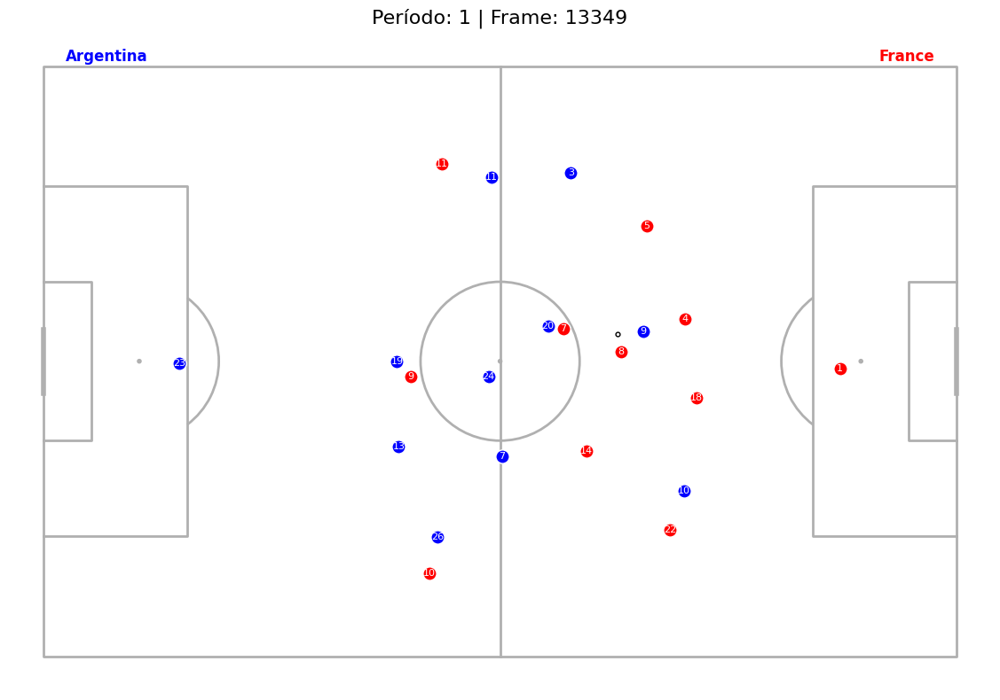

In [54]:
# Plotar o frame
fig, ax = plot_frame(frame, title=title)
plt.tight_layout()
plt.show()

%% [markdown]
## Criando uma Animação de Sequência

Visualizações estáticas são úteis, mas animações podem nos dar uma compreensão muito melhor do movimento dos jogadores ao longo do tempo.
Vamos criar uma animação de uma sequência de frames para visualizar como os jogadores e a bola se movem durante o jogo.

Vamos usar o módulo de animação do Matplotlib, que nos permite criar animações quadro a quadro.

In [36]:
# %%
# Definir uma função para criar animações a partir de nossos dados de rastreamento
# %%
# Definir uma função para criar animações a partir de nossos dados de rastreamento
def create_animation(df, start_frame, num_frames=100, fps=10, show_player_labels=True, save_path=None, format='html'):
    """
    Criar uma animação a partir de dados de rastreamento.
    
    Parâmetros:
    -----------
    df : pandas.DataFrame
        DataFrame contendo dados de rastreamento
    start_frame : int
        Índice de frame inicial ou frame_id
    num_frames : int, padrão=100
        Número de frames para animar
    fps : int, padrão=10
        Frames por segundo na animação
    show_player_labels : bool, padrão=True
        Se deve mostrar os números das camisas dos jogadores
    save_path : str, opcional
        Caminho para salvar a animação (None para não salvar)
    format : str, padrão='html'
        Formato para salvar a animação ('html', 'gif', 'mp4')
        
    Retorna:
    --------
    Objeto de animação ou objeto de exibição HTML
    """
    # Configurar a figura e o campo
    pitch = Pitch(pitch_type='skillcorner', pitch_length=105, pitch_width=68)
    fig, ax = pitch.draw(figsize=(12, 8))
    
    # Encontrar o índice de início correto em nosso dataframe
    # Isso lida se passamos um número de frame ou índice
    if isinstance(start_frame, int) and start_frame >= 0 and start_frame < len(df):
        start_idx = start_frame
    else:
        # Se frame_id é fornecido, encontre seu índice
        mask = df['frame_id'] == start_frame
        if mask.any():
            start_idx = df[mask].index[0]
        else:
            start_idx = 0
            print(f"Aviso: Frame {start_frame} não encontrado. Começando do início.")
    
    # Extrair a sequência de frames para animar
    end_idx = min(start_idx + num_frames, len(df))
    frames_to_animate = df.iloc[start_idx:end_idx]
    
    # Inicializar o objeto de texto do título
    title_text = ax.text(36, 38, "", fontsize=14, ha='center', va='center')
    
    # Função de atualização da animação - chamada para cada frame
    def update(frame_idx):
        # Limpar os eixos para o novo frame
        ax.clear()
        pitch.draw(ax=ax)
        
        # Obter os dados do frame atual
        frame_data = frames_to_animate.iloc[frame_idx]
        
        # Obter o timestamp e id do frame para o título
        timestamp = frame_data['timestamp']
        frame_id = frame_data['frame_id']
        period = frame_data['period_id']
        
        # Criar e atualizar o título
        title = f"Período: {period} | Tempo: {timestamp} | Frame: {frame_id}"
        ax.set_title(title, fontsize=16)
        
        # Plotar o frame
        plot_frame(frame_data, ax=ax, show_player_labels=show_player_labels)
        
        # Retornar uma lista vazia (necessário para alguns métodos de animação)
        return []
    
    # Criar a animação - isso chama a função update() para cada frame
    anim = animation.FuncAnimation(fig, update, frames=len(frames_to_animate), 
                                   interval=1000/fps, blit=False)
    
    # Salvar a animação se um caminho for fornecido
    if save_path:
        if format.lower() == 'gif':
            anim.save(save_path, writer='pillow', fps=fps, dpi=80)
            return anim
        elif format.lower() == 'mp4':
            # Tentar usar o escritor ffmpeg se disponível, caso contrário usar HTML
            try:
                Writer = animation.writers['ffmpeg']
                writer = Writer(fps=fps, metadata=dict(artist='Me'), bitrate=1800)
                anim.save(save_path, writer=writer, dpi=150)
                return anim
            except:
                print("FFmpeg não disponível. Alternando para saída HTML.")
                # Padrão para HTML se FFmpeg não estiver disponível
                html_obj = HTML(anim.to_jshtml())
                return html_obj
        else:  # Padrão para HTML
            html_obj = HTML(anim.to_jshtml())
            return html_obj
    
    # Se não houver caminho de salvamento, retornar HTML para exibição no notebook
    return HTML(anim.to_jshtml())

%% [markdown]
Agora vamos criar uma animação para uma sequência de frames.
Vamos encontrar um período interessante quando a bola está em jogo.

In [37]:
# %%
# Encontrar todos os frames onde a bola está em jogo
alive_sequences = df[df['ball_state'] == 'alive']

In [39]:
# Vamos começar a partir do 100º frame onde a bola está viva
# Este deve ser um momento interessante na partida
start_idx = alive_sequences.index[3000]

Animation size has reached 21015376 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


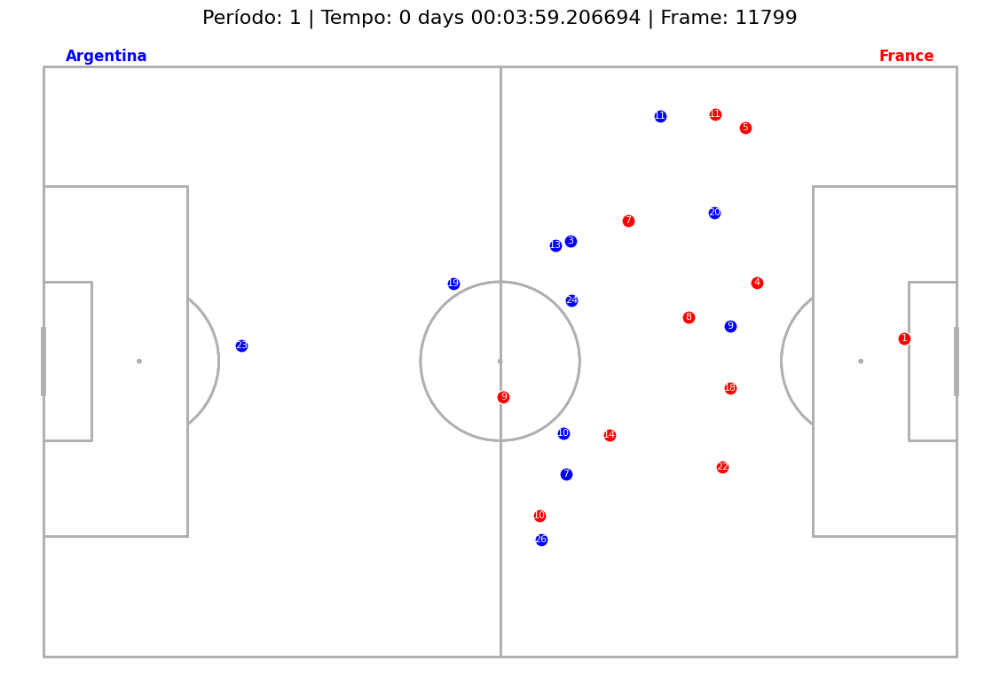

In [40]:
# Criar a animação - 100 frames a 10 frames por segundo
animation_html = create_animation(df, start_idx, num_frames=1000, fps=10, 
                                 show_player_labels=True, format='html')

In [41]:
# Exibir a animação no notebook
animation_html

%% [markdown]
### Análise da Animação

Tire um tempo para observar a animação:

- Como os times mantêm suas formações enquanto se movem?
- Como os jogadores reagem ao movimento da bola?
- Você consegue identificar algum padrão tático na forma como os jogadores se movem?
- Quais jogadores fazem os movimentos mais significativos?

Estes são os tipos de perguntas que os dados de rastreamento nos ajudam a responder!

%% [markdown]
## Salvando Animações em Diferentes Formatos

Agora vamos demonstrar como salvar nossas animações em diferentes formatos: GIF, MP4 e HTML.

In [ ]:
# %%
# Criar diretório para arquivos de saída se não existir
output_dir = "animations"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

In [ ]:
# Definir frame inicial e número de frames para animar
start_idx = alive_sequences.index[200]  # Ponto de partida diferente
num_frames = 50  # Menos frames para processamento mais rápido

GIF salvo em animations/tracking_animation.gif


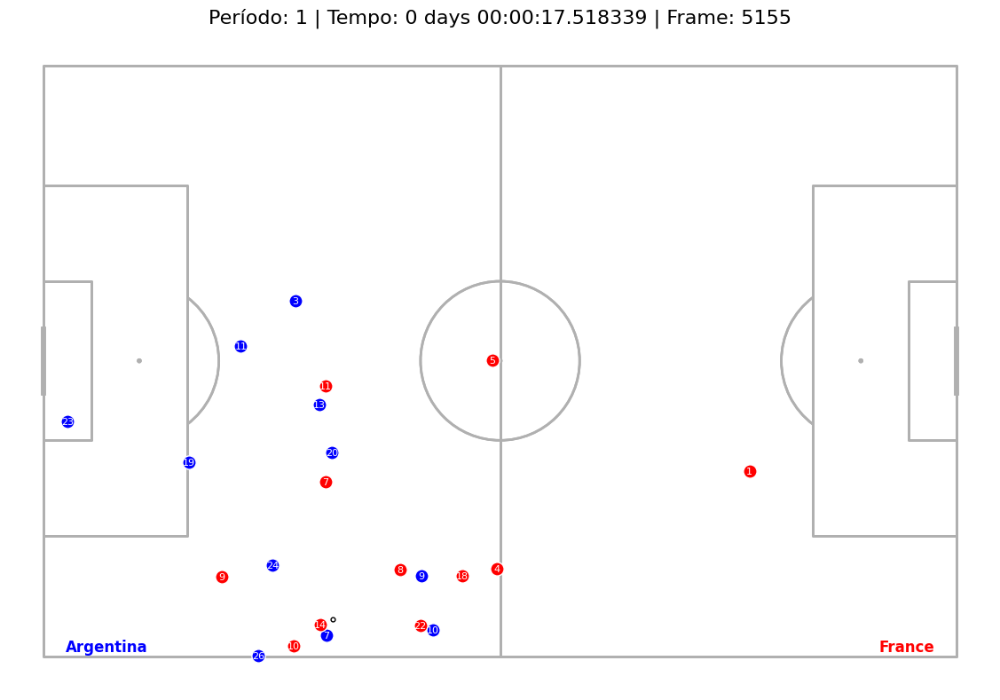

In [ ]:
# Salvar como GIF
gif_path = os.path.join(output_dir, "tracking_animation.gif")
create_animation(df, start_idx, num_frames=num_frames, fps=10, 
                save_path=gif_path, format='gif')
print(f"GIF salvo em {gif_path}")

FFmpeg não disponível. Alternando para saída HTML.
MP4 salvo em animations/tracking_animation.mp4


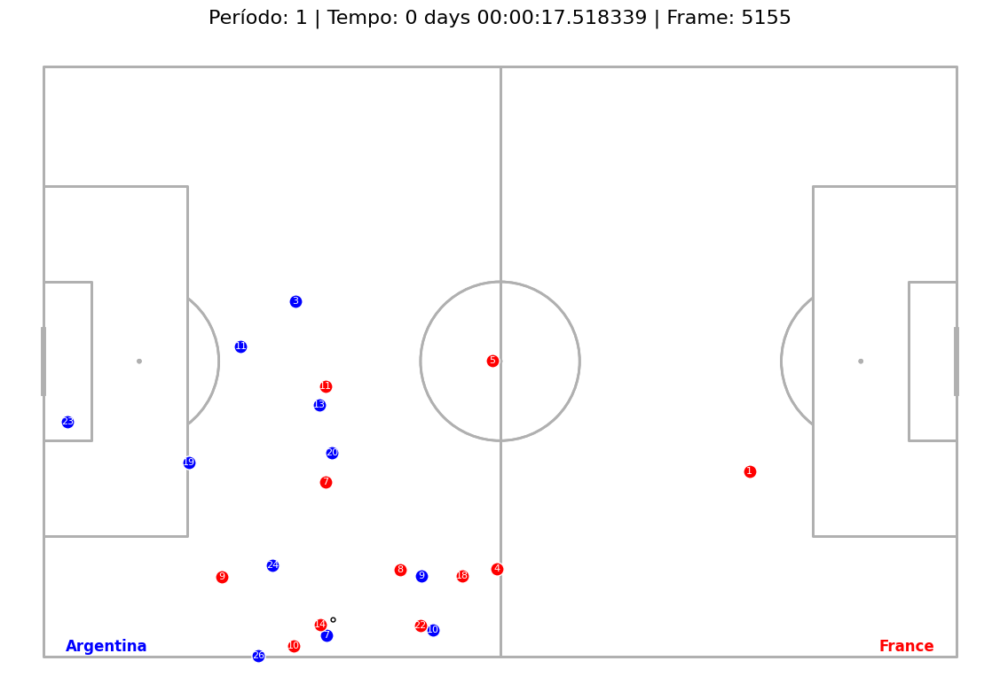

In [ ]:
# Salvar como MP4 (se ffmpeg estiver disponível)
mp4_path = os.path.join(output_dir, "tracking_animation.mp4")
try:
    create_animation(df, start_idx, num_frames=num_frames, fps=10, 
                    save_path=mp4_path, format='mp4')
    print(f"MP4 salvo em {mp4_path}")
except Exception as e:
    print(f"Não foi possível salvar MP4: {e}")

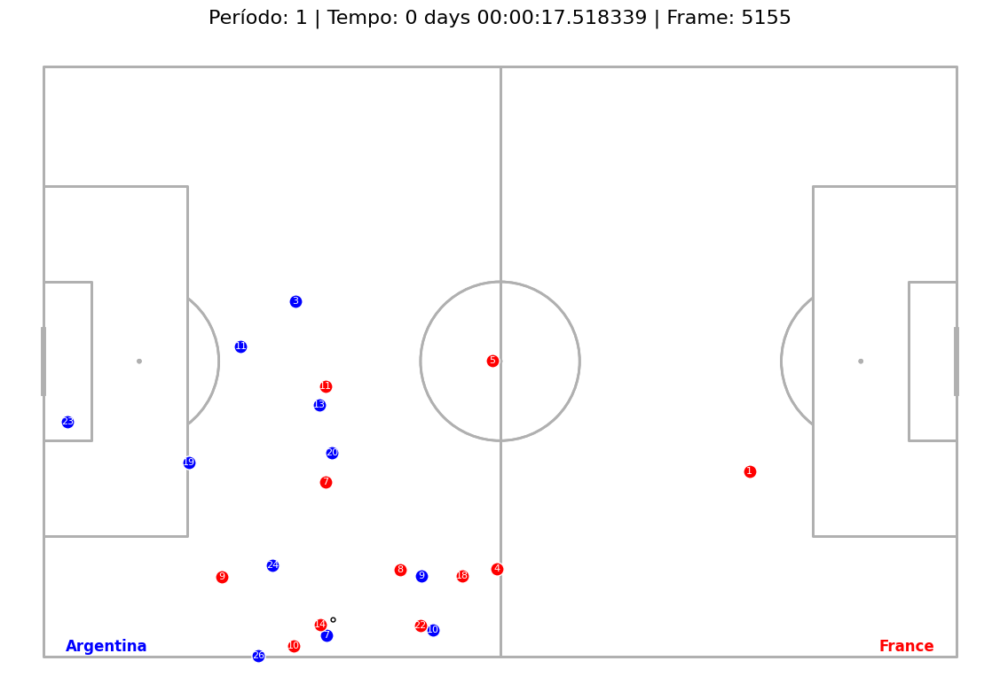

In [ ]:
# Salvar como HTML
html_path = os.path.join(output_dir, "tracking_animation.html")
html_anim = create_animation(df, start_idx, num_frames=num_frames, fps=10, format='html')

In [ ]:
# Salvar o HTML em um arquivo
with open(html_path, "w") as f:
    f.write(html_anim.data)
print(f"HTML salvo em {html_path}")

HTML salvo em animations/tracking_animation.html


%% [markdown]
## Explorando um Momento Tático: Messi no Terceiro Terceiro

Um dos aspectos mais interessantes dos dados de rastreamento é a capacidade de isolar situações específicas táticas.
Nesta seção, vamos nos concentrar em momentos quando Lionel Messi está no terceiro terceiro da área de campo.

O terceiro terceiro é uma área crítica onde jogadores como Messi podem criar oportunidades de gol.
Ao analisar esses momentos, podemos entender:

- Posicionamento de Messi em áreas perigosas
- Como os companheiros de equipe se posicionam ao redor dele
- Resposta defensiva dos oponentes
- Padrões em seu movimento em situações de ataque

In [46]:
# %%
# Primeiro, vamos encontrar Messi em nosso conjunto de dados de jogadores
# Nota: Este é um espaço reservado - você precisará verificar se Messi está neste conjunto de dados
messi_id = None

In [47]:
# Procurar Messi em nosso dicionário player_info
for player_id, info in player_info.items():
    if "Messi" in info['name']:
        messi_id = player_id
        print(f"Encontrado Messi! ID do jogador: {messi_id}")
        print(f"Time: {info['team_name']}, Camisa: {info['jersey_no']}, Posição: {info['position']}")
        break

Encontrado Messi! ID do jogador: 1531
Time: Argentina, Camisa: 10, Posição: Right Wing


In [48]:
# Se Messi não for encontrado neste jogo, use um jogador substituto
# Você pode substituir com outro jogador estelar deste jogo
if messi_id is None:
    print("Messi não encontrado neste conjunto de dados. Você pode substituir com outro jogador.")
    # Para demonstração, usaremos o primeiro atacante que encontrarmos
    for player_id, info in player_info.items():
        if info['position'] in ['CF', 'RW', 'LW', 'ST', 'SS', 'FW']:
            messi_id = player_id
            print(f"Usando {info['name']} (#{info['jersey_no']}) como substituto.")
            break

%%
Definir o "terceiro terceiro" no sistema de coordenadas
Para dados PFF com dimensões de campo aproximadamente 105 x 68 metros
O terceiro terceiro começa a 70 metros da linha de gol do time próprio

In [49]:
# Precisamos determinar qual time Messi está atacando
# Isso requer verificar o ID do time e o período do jogo
team_id = player_info[messi_id]['team_id']

# Encontrar frames onde o jogador está no terceiro terceiro com a bola em jogo
final_third_frames = []

# Vamos verificar cada período, pois os times mudam de lado ao intervalo
for period in df['period_id'].unique():
    period_df = df[df['period_id'] == period]
    
    # Determinar a direção de ataque neste período
    # Em período 1, o time próprio geralmente ataca da direita para esquerda
    # Em período 2, eles mudam de direção
    attacking_right_to_left = (period % 2 == 1 and team_id == home_team_id) or \
                            (period % 2 == 0 and team_id == away_team_id)
    
    # Definir limite de coordenada com base na direção de ataque
    if attacking_right_to_left:
        # Quando atacando da direita para esquerda, o terceiro terceiro é x < 35
        x_threshold = -17.5
        threshold_condition = lambda x: x < x_threshold
    else:
        # Quando atacando da esquerda para direita, o terceiro terceiro é x > 70
        x_threshold = 17.5
        threshold_condition = lambda x: x > x_threshold
    
    # Filtrar frames onde o jogador está no terceiro terceiro
    for idx, frame in period_df.iterrows():
        player_x_col = f"{messi_id}_x"
        
        if player_x_col in frame and not pd.isna(frame[player_x_col]):
            player_x = frame[player_x_col]
            
            if threshold_condition(player_x) and frame['ball_state'] == 'alive':
                final_third_frames.append(idx)

print(f"Encontrados {len(final_third_frames)} frames onde o jogador está no terceiro terceiro com a bola em jogo.")



Encontrados 16453 frames onde o jogador está no terceiro terceiro com a bola em jogo.


In [50]:
final_third_frames

[13036,
 13037,
 13038,
 13039,
 13040,
 13041,
 13042,
 13043,
 13044,
 13045,
 13046,
 13047,
 13048,
 13049,
 13050,
 13051,
 13052,
 13053,
 13054,
 13055,
 13056,
 13057,
 13058,
 13059,
 13060,
 13061,
 13062,
 13063,
 13064,
 13065,
 13066,
 13067,
 13068,
 13069,
 13070,
 13071,
 13072,
 13073,
 13074,
 13075,
 13076,
 13077,
 13078,
 13079,
 13080,
 13081,
 13082,
 13083,
 13084,
 13085,
 13086,
 13087,
 13088,
 13089,
 13090,
 13091,
 13092,
 13093,
 13094,
 13095,
 13096,
 13097,
 13098,
 13099,
 13100,
 13101,
 13102,
 13103,
 13104,
 13105,
 13106,
 13107,
 13108,
 13109,
 13110,
 13111,
 13112,
 13113,
 13114,
 13115,
 13116,
 13117,
 13118,
 13119,
 13120,
 13121,
 13122,
 13123,
 13124,
 13125,
 13126,
 13127,
 13128,
 13129,
 13130,
 13131,
 13132,
 13133,
 13134,
 13135,
 13136,
 13137,
 13138,
 13139,
 13140,
 13141,
 13142,
 13143,
 13144,
 13145,
 13146,
 13147,
 13148,
 13149,
 13150,
 13151,
 13152,
 13153,
 13154,
 13155,
 13156,
 13157,
 13158,
 13159,
 13160,


In [51]:
# frames ultimo terceiro
messi_f3 = df_com_velocidade_aceleracao[
    df_com_velocidade_aceleracao['frame_id'].isin(final_third_frames)        
]

# %%


In [ ]:
# Se encontrarmos momentos relevantes, exibir alguns deles
if final_third_frames:
    print("\nVamos visualizar alguns desses momentos:")
    
    # Tomar uma amostra de frames para visualizar (os primeiros 3 momentos)
    sample_frames = final_third_frames[:min(3, len(final_third_frames))]
    
    fig, axes = plt.subplots(1, len(sample_frames), figsize=(18, 6))
    if len(sample_frames) == 1:
        axes = [axes]  # Manipular caso com apenas um frame
    
    for i, frame_idx in enumerate(sample_frames):
        frame = df.loc[frame_idx]
        timestamp = frame['timestamp']
        period = frame['period_id']
        
        # Plotar o frame
        title = f"Período {period}: {timestamp:.1f}s"
        plot_frame(frame, title=title, ax=axes[i])
        
        # Destacar o jogador que estamos focando
        player_x = frame[f"{messi_id}_x"]
        player_y = frame[f"{messi_id}_y"]
        axes[i].plot(player_x, player_y, 'yo', markersize=12, alpha=0.7)  # Yellow circle
    
    plt.tight_layout()
    plt.show()
else:
print("Nenhum jogador selecionado para análise.")

%% [markdown]
### Análise Tática de Momentos no Terceiro Terceiro

Ao analisar jogadores como Messi no terceiro terceiro, vários aspectos são importantes:

1. **Posicionamento em relação aos defensores**: Observe como os defensores se posicionam quando nosso jogador de foco entra em áreas perigosas.

2. **Suporte de companheiros**: Observe como companheiros se movem para fornecer opções de passe ou criar espaço.

3. **Resposta defensiva**: Como rápida é a resposta dos defensores ao nosso jogador? Eles mantêm estrutura ou saem de posição?

4. **Avaliação de espaço**: Olhe para momentos onde nosso jogador encontra buracos de espaço entre as linhas defensivas.

5. **Velocidade de transição**: Observe como rapidamente a equipe se move para posições de ataque quando nosso jogador recebe a bola no terceiro terceiro.

Este tipo de análise pode revelar padrões táticos que podem não ser evidentes a partir de vídeo de jogo ou dados de evento. Os dados de rastreamento nos permitem medir relações espaciais entre jogadores e entender como atacantes como Messi manipulam defesas através de suas posições e movimentos.

Você pode adaptar esta análise para se concentrar em qualquer jogador ou situação tática específica, como:
- Contra-ataques
- Configurações de bola em situações de cobrança de pênalti
- Gatilhos de pressão
- Formação defensiva contra oponentes específicos

In [ ]:
# %%
# Finalmente, vamos analisar o movimento do jogador em questão no terceiro terceiro
if final_third_frames and len(final_third_frames) > 5:
    # Encontrar uma sequência de frames no terceiro terceiro
    # Usaremos os primeiros 30 frames ou todos disponíveis se menos
    num_frames_to_analyze = min(30, len(final_third_frames))
    
    # Obter o índice inicial e visualizar caminhos do jogador
    start_idx = final_third_frames[0]
    
    # Focar no jogador e próximos companheiros/oponentes
    fig, ax = plot_player_paths(df, start_idx, num_frames=num_frames_to_analyze, 
                               include_ball=True)
    
    # Destacar nosso jogador de foco mais claramente
    sequence_df = df.iloc[start_idx:start_idx+num_frames_to_analyze].copy()
    
    # Obter coordenadas do jogador para cada frame, removendo valores NaN
    x_col = f"{messi_id}_x"
    y_col = f"{messi_id}_y"
    player_df = sequence_df[[x_col, y_col]].dropna()
    
    if len(player_df) >= 2:  # Precisa de pelo menos 2 pontos para desenhar um caminho
        # Obter todas as posições x e y para este jogador
        x_values = player_df[x_col].values
        y_values = player_df[y_col].values
        
        # Plotar um caminho mais visível para nosso jogador de foco
        pitch = Pitch(pitch_type='skillcorner', pitch_length=105, pitch_width=68)
        pitch.lines(x_values, y_values, lw=4, color='yellow', alpha=0.8, zorder=10, ax=ax)
        
        # Adicionar entrada de legenda para o jogador destacado
        player_name = player_info[messi_id]['name']
        jersey_no = player_info[messi_id]['jersey_no']
        ax.plot([], [], color='yellow', lw=4, label=f"{player_name} (#{jersey_no})")
        ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), frameon=False, ncol=3)
    
    plt.show()

In [42]:
def calcular_velocidade_aceleracao(df, frame_column='frame', player_columns=None, tempo_entre_frames=0.04):
    """
    Calcula a velocidade e aceleração para cada jogador no dataframe de rastreamento.
    
    Parâmetros:
    -----------
    df : pandas.DataFrame
        DataFrame contendo os dados de rastreamento dos jogadores
    frame_column : str, opcional
        Nome da coluna que contém o número do frame
    player_columns : list, opcional
        Lista de prefixos para colunas de jogadores no formato ['player1', 'player2', ...]
        Se None, detectará automaticamente colunas que tenham "_x" e "_y"
    tempo_entre_frames : float, opcional
        Tempo entre frames consecutivos em segundos (padrão: 0.04s = 25fps)
        
    Retorna:
    --------
    pandas.DataFrame
        DataFrame original com colunas adicionais para velocidade e aceleração de cada jogador
    """
    # Crie uma cópia do dataframe para não modificar o original
    result_df = df.copy()
    
    # Se player_columns não for fornecido, detecte automaticamente
    if player_columns is None:
        # Encontre todas as colunas com sufixo "_x"
        x_columns = [col for col in df.columns if col.endswith('_x')]
        # Extraia os prefixos dos jogadores
        player_columns = [col[:-2] for col in x_columns]
    
    # Ordene o dataframe por frame para garantir a sequência correta
    result_df = result_df.sort_values(by=frame_column)
    
    # Para cada jogador, calcule velocidade e aceleração
    for player in player_columns:
        x_col = f"{player}_x"
        y_col = f"{player}_y"
        v_col = f"{player}_velocidade"
        a_col = f"{player}_aceleracao"
        
        # Verifique se as colunas x e y existem para este jogador
        if x_col not in df.columns or y_col not in df.columns:
            continue
        
        # Calcule a distância euclidiana entre frames consecutivos
        result_df[f"{player}_dx"] = result_df[x_col].diff()
        result_df[f"{player}_dy"] = result_df[y_col].diff()
        result_df[f"{player}_dist"] = np.sqrt(
            result_df[f"{player}_dx"]**2 + result_df[f"{player}_dy"]**2
        )
        
        # Calcule a diferença entre frames
        result_df['frame_diff'] = result_df[frame_column].diff()
        
        # Calcule a velocidade considerando o tempo entre frames
        # Velocidade = distância / tempo
        result_df[v_col] = np.where(
            result_df['frame_diff'] == 1,  # Verifique se os frames são consecutivos
            result_df[f"{player}_dist"] / tempo_entre_frames,  # Se sim, calcule a velocidade
            np.nan  # Se não, atribua NaN
        )
        
        # Calcule a aceleração (mudança na velocidade)
        result_df[a_col] = np.where(
            result_df['frame_diff'] == 1,  # Verifique se os frames são consecutivos
            result_df[v_col].diff() / tempo_entre_frames,  # Se sim, calcule a aceleração
            np.nan  # Se não, atribua NaN
        )
        
        # Remova colunas temporárias
        result_df = result_df.drop(columns=[f"{player}_dx", f"{player}_dy", f"{player}_dist"])
    
    # Remova a coluna temporária de diferença de frames
    if 'frame_diff' in result_df.columns:
        result_df = result_df.drop(columns=['frame_diff'])
    
    return result_df

In [43]:
# Exemplo de uso
df_com_velocidade_aceleracao = calcular_velocidade_aceleracao(
    df, 
    frame_column='frame_id', 
    tempo_entre_frames=1/30  # Ajuste conforme a frequência de captura (25fps = 0.04s)
)

In [44]:
import pandas as pd
import numpy as np
from scipy.spatial.distance import euclidean

def detectar_jogador_com_bola(df, dist_threshold=1.0, conf_threshold=0.8, 
                              usar_velocidade=True, colunas_custom=None):
    """
    Detecta qual jogador está com a bola em cada frame e adiciona uma coluna ao dataframe.
    
    Parâmetros:
    -----------
    df : DataFrame
        Dataframe contendo dados de posição dos jogadores e da bola.
        Espera-se que tenha colunas no formato:
        - 'frame_id': ID do frame
        - 'player_id': ID do jogador
        - 'x', 'y', 'z': coordenadas do jogador
        - 'ball_x', 'ball_y', 'ball_z': coordenadas da bola
        - (opcional) 'vx', 'vy', 'vz': velocidade do jogador
        - (opcional) 'ball_vx', 'ball_vy', 'ball_vz': velocidade da bola
    
    dist_threshold : float, opcional
        Distância máxima (em metros) para considerar que um jogador está com a bola.
    
    conf_threshold : float, opcional
        Limiar de confiança (0-1) para considerar que o jogador está com a bola.
    
    usar_velocidade : bool, opcional
        Se True, considera a velocidade da bola e do jogador para melhorar a confiança.
    
    colunas_custom : dict, opcional
        Dicionário para especificar nomes personalizados de colunas.
    
    Retorna:
    --------
    DataFrame
        Dataframe original com uma nova coluna 'player_with_ball_id' indicando o ID do
        jogador com a bola, e 'player_with_ball_conf' indicando a confiança.
    """
    # Cria uma cópia do dataframe original
    result_df = df.copy()
    
    # Define os nomes das colunas
    col_names = {
        'frame': 'frame_id',
        'player': 'player_id',
        'x': 'x', 'y': 'y', 'z': 'z',
        'ball_x': 'ball_x', 'ball_y': 'ball_y', 'ball_z': 'ball_z',
        'vx': 'vx', 'vy': 'vy', 'vz': 'vz',
        'ball_vx': 'ball_vx', 'ball_vy': 'ball_vy', 'ball_vz': 'ball_vz'
    }
    
    # Atualiza com colunas customizadas, se fornecidas
    if colunas_custom:
        col_names.update(colunas_custom)
    
    # Inicializa colunas para armazenar o ID do jogador com a bola e a confiança
    result_df['player_with_ball_id'] = np.nan
    result_df['player_with_ball_conf'] = 0.0
    
    # Processa cada frame separadamente
    for frame_id in result_df[col_names['frame']].unique():
        frame_data = result_df[result_df[col_names['frame']] == frame_id]
        
        # Obtém a posição da bola no frame atual
        ball_pos = frame_data[[col_names['ball_x'], col_names['ball_y'], col_names['ball_z']]].iloc[0].values
        
        min_dist = float('inf')
        best_player_id = None
        best_conf = 0.0
        
        # Para cada jogador, calcula a distância até a bola
        for _, player_row in frame_data.iterrows():
            player_id = player_row[col_names['player']]
            player_pos = player_row[[col_names['x'], col_names['y'], col_names['z']]].values
            
            # Calcula a distância euclidiana entre o jogador e a bola
            distance = euclidean(player_pos, ball_pos)
            
            # Calcula a confiança baseada na distância
            # Quanto mais próximo da bola, maior a confiança
            distance_conf = max(0, 1 - (distance / dist_threshold)) if distance <= dist_threshold else 0
            
            # Se a confiança baseada na distância for zero, pula para o próximo jogador
            if distance_conf == 0:
                continue
            
            # Confiança inicial baseada apenas na distância
            confidence = distance_conf
            
            # Se usar_velocidade=True e as colunas de velocidade existem, refina a confiança
            if usar_velocidade and all(col in frame_data.columns for col in 
                                      [col_names['vx'], col_names['vy'], col_names['vz'],
                                       col_names['ball_vx'], col_names['ball_vy'], col_names['ball_vz']]):
                
                # Vetor de velocidade do jogador
                player_vel = player_row[[col_names['vx'], col_names['vy'], col_names['vz']]].values
                
                # Vetor de velocidade da bola
                ball_vel = player_row[[col_names['ball_vx'], col_names['ball_vy'], col_names['ball_vz']]].values
                
                # Calcula a similaridade de velocidade (correlação entre vetores)
                vel_magnitude_player = np.linalg.norm(player_vel)
                vel_magnitude_ball = np.linalg.norm(ball_vel)
                
                if vel_magnitude_player > 0 and vel_magnitude_ball > 0:
                    vel_similarity = np.dot(player_vel, ball_vel) / (vel_magnitude_player * vel_magnitude_ball)
                    vel_similarity = (vel_similarity + 1) / 2  # Normaliza para 0-1
                    
                    # Adiciona à confiança (com peso menor)
                    confidence = 0.7 * distance_conf + 0.3 * vel_similarity
            
            # Atualiza o melhor jogador se a confiança for maior
            if confidence > best_conf:
                best_conf = confidence
                best_player_id = player_id
                min_dist = distance
        
        # Atualiza o dataframe com o jogador com a bola e a confiança
        if best_player_id is not None and best_conf >= conf_threshold:
            mask = result_df[col_names['frame']] == frame_id
            result_df.loc[mask, 'player_with_ball_id'] = best_player_id
            result_df.loc[mask, 'player_with_ball_conf'] = best_conf
    
    return result_df

In [45]:
# Exemplo de uso
# Supondo que seu dataframe df já esteja carregado
df_com_posse = detectar_jogador_com_bola(
    df_com_velocidade_aceleracao, 
    dist_threshold=1.5,          # Distância máxima em metros para considerar posse
    conf_threshold=0.7,          # Confiança mínima para registrar a posse
    usar_velocidade=True         # Usar dados de velocidade para melhorar precisão
)

KeyError: 'player_id'